In [15]:
import numpy as np
from matplotlib import pyplot as plt
import csv

%matplotlib inline

import xarray as xr
import lib_ecofun as lef
from importlib import reload
reload(lef)
from scipy.optimize import curve_fit, minimize

In [126]:
fcu = 0.5
inicond = lef.inicond_yr(2000)
inicond['Kf_ini'] = inicond['Kf_ini']*lef.fossil_capacity_util/fcu

In [95]:
inicond

{'Y_ini': 1, 'Kg_ini': array(0.07815846), 'Kf_ini': 1.15230193125}

In [106]:
obs = dict()
#obs['Ig_ratio'] = lef.Ig_obs/(lef.Ig_obs+lef.If_obs)
obs['Eg_ratio'] = lef.Eg_ratio#.sel(year = slice(2015, None))

In [101]:
Ef_ini = fcu*lef.inicond_yr(2000)['Kf_ini']
Pf_ini = params['gamma_f'] * (Ef_ini - params['eta_f'] * Ef_ini**params['h_f'])


In [102]:
obs['Pf'] = (lef.Pf_obs/lef.Pf_obs.sel(year=2000)).rolling(year=10,min_periods=1).mean()/Pf_ini

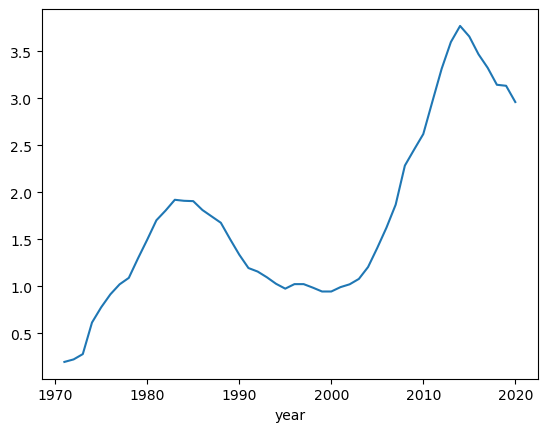

In [103]:
obs['Pf'].plot()

In [135]:
parnames = ['beta_0', 'r_inv', 'a', 'delta_sig']
initial_guess = [0.2, 0.1, 1., 0.7]#, 1.]
bounds = [(-0.5, 0.5), (0.01, 0.4), (0.5, 1.5), (0.01, 2.)]#, (0.5, 1.5)]

year_ini = 2000

params = lef.default_params.copy()
print(params)
print('-------------')
params['growth'] = 0.029 # fixing Growth!

verbose = True
all_green = False
I_weight = 1.
# obs = None
# obs = dict()
# obs['Ig_ratio'] = lef.Ig_obs/(lef.Ig_obs+lef.If_obs)
# obs['Eg_ratio'] = lef.Eg_ratio

# linear_gdp = 0.02

# Step 5: Use an optimization function to find the best parameters
result = minimize(lef.cost_function, initial_guess, bounds = bounds, args = (parnames, params, year_ini, lef.inicond_yr(year_ini), verbose, all_green, I_weight, obs), tol = 1e-10)
# result = minimize(lef.cost_function, initial_guess, bounds = bounds, args = (parnames, params, year_ini, lef.inicond_yr(year_ini), verbose, all_green, I_weight, obs, linear_gdp), tol = 1e-10)
print(result)

{'growth': 0.01, 'eps': 1, 'a': 1, 'b': 1, 'gamma_f': 0.5, 'gamma_g': 0.5, 'eta_g': 0.2, 'eta_f': 0.2, 'h_g': 0.5, 'h_f': 0.5, 'r_inv': 0.1, 'beta_0': 0.2, 'delta_sig': 0.5, 'delta_g': 0.01, 'delta_f': 0.01, 'f_heavy': 0.1}
-------------
False 1.0 {'Eg_ratio': <xarray.DataArray (year: 59)>
array([0.06445519, 0.06516204, 0.06423987, 0.06390145, 0.0632996 ,
       0.06240231, 0.06275118, 0.06231038, 0.0598148 , 0.06527657,
       0.06561374, 0.06222023, 0.06216026, 0.06474634, 0.06588326,
       0.06803658, 0.06985936, 0.07187162, 0.07396094, 0.07347961,
       0.07309479, 0.07285027, 0.07142948, 0.0710847 , 0.06987618,
       0.07182692, 0.07301195, 0.07286488, 0.07653918, 0.07632168,
       0.07871824, 0.07755703, 0.07847491, 0.07890869, 0.07853059,
       0.07815846, 0.07552836, 0.07566855, 0.07334207, 0.07518   ,
       0.0756382 , 0.07705343, 0.07747336, 0.08245706, 0.08564856,
       0.08797048, 0.08980997, 0.09414955, 0.09847355, 0.10218171,
       0.10504495, 0.10980251, 0.113372

In [ ]:
year_ini = 2000

params = lef.default_params.copy()
params['growth'] = 0.029 # fixing Growth!

for par, parval in zip(parnames, result.x):
    params[par] = parval

#resu_hist = lef.run_model(inicond = lef.inicond_yr(year_ini), params = params, n_iter = 100, verbose = True, rule = 'maxgreen', year_ini = year_ini, linear_gdp = linear_gdp)
resu_hist = lef.run_model(inicond = lef.inicond_yr(year_ini), params = params, n_iter = 100, verbose = True, rule = 'maxgreen', year_ini = year_ini)
lef.plot_resu(resu_hist, year_ini = year_ini)
lef.plot_resuvsobs(resu_hist, year_ini = year_ini)

yini = year_ini
#print(yini + resu['year_peak'], yini + resu['year_halved'], yini + resu['year_zero'])

cost = lef.costfun(resu_hist, obs)#, weights = weights)
print(cost)

In [111]:
E_obs = xr.load_dataarray('Etot_hist_1965-2022.nc')
E_obs /= E_obs.sel(year = 2000)

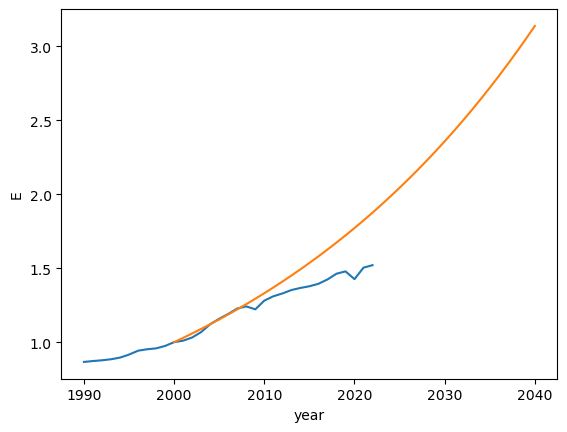

In [136]:
E_obs.sel(year = slice(1990, 2040)).plot()
resu_hist.sel(year = slice(1990, 2040)).E.plot()

In [ ]:
# year_ini = 2000

# linear_gdp = 0.02

# params = lef.default_params.copy()
# params['growth'] = 0.029 # fixing Growth!

# for par, parval in zip(parnames, result.x):
#     params[par] = parval

# resu_hist = lef.run_model(inicond = lef.inicond_yr(year_ini), params = params, n_iter = 100, verbose = True, rule = 'maxgreen', year_ini = year_ini, linear_gdp = linear_gdp)
# lef.plot_resu(resu_hist, year_ini = year_ini)
# lef.plot_resuvsobs(resu_hist, year_ini = year_ini)

# yini = year_ini
# #print(yini + resu['year_peak'], yini + resu['year_halved'], yini + resu['year_zero'])

# cost = lef.costfun(resu_hist, obs)#, weights = weights)
# print(cost)

In [32]:
1.06**20

3.207135472212848

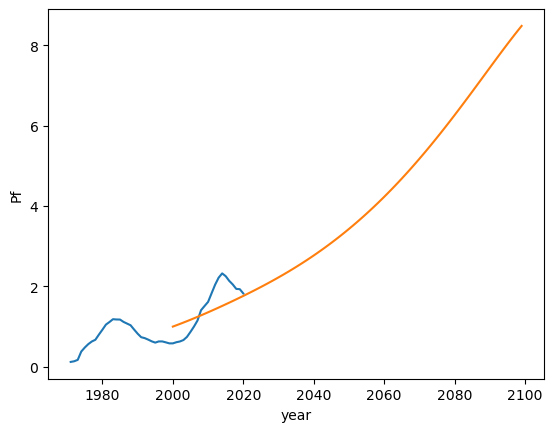

In [137]:
(lef.Pf_obs/lef.Pf_obs.sel(year=2000)).rolling(year=10,min_periods=1).mean().plot()
(resu_hist.Pf/resu_hist.Pf.sel(year=2000)).plot()

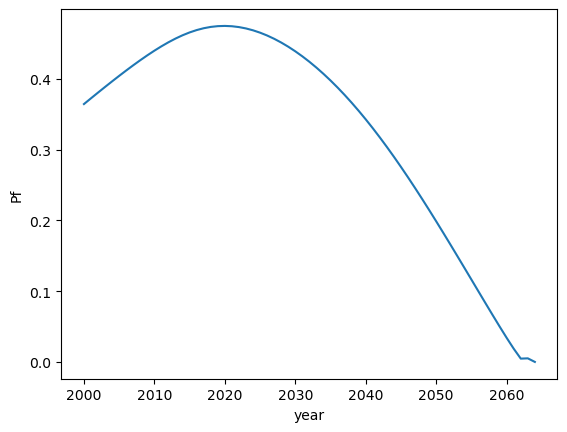

In [53]:
resu_hist.Pf.plot()


### FIT with E_obs and Eg_ratio

In [142]:
obs['E'] = E_obs

In [143]:
# parnames = ['beta_0', 'r_inv', 'a', 'delta_sig']
# initial_guess = [0.2, 0.1, 1., 0.7]#, 1.]
# bounds = [(-0.5, 0.5), (0.01, 0.4), (0.5, 1.5), (0.01, 2.)]#, (0.5, 1.5)]

parnames = ['growth', 'beta_0', 'r_inv', 'a', 'delta_sig']
initial_guess = [0.02, 0.2, 0.1, 1., 0.7]#, 1.]
bounds = [(0.001, 0.05), (-0.5, 0.5), (0.01, 0.4), (0.5, 1.5), (0.01, 2.)]#, (0.5, 1.5)]

year_ini = 2000

params = lef.default_params.copy()
print(params)
print('-------------')
#params['growth'] = 0.029 # fixing Growth!

verbose = True
all_green = False
I_weight = 1.
# obs = None
# obs = dict()
# obs['Ig_ratio'] = lef.Ig_obs/(lef.Ig_obs+lef.If_obs)
# obs['Eg_ratio'] = lef.Eg_ratio

# linear_gdp = 0.02

# Step 5: Use an optimization function to find the best parameters
result = minimize(lef.cost_function, initial_guess, bounds = bounds, args = (parnames, params, year_ini, lef.inicond_yr(year_ini), verbose, all_green, I_weight, obs), tol = 1e-10)
# result = minimize(lef.cost_function, initial_guess, bounds = bounds, args = (parnames, params, year_ini, lef.inicond_yr(year_ini), verbose, all_green, I_weight, obs, linear_gdp), tol = 1e-10)
print(result)

{'growth': 0.01, 'eps': 1, 'a': 1, 'b': 1, 'gamma_f': 0.5, 'gamma_g': 0.5, 'eta_g': 0.2, 'eta_f': 0.2, 'h_g': 0.5, 'h_f': 0.5, 'r_inv': 0.1, 'beta_0': 0.2, 'delta_sig': 0.5, 'delta_g': 0.01, 'delta_f': 0.01, 'f_heavy': 0.1}
-------------
False 1.0 {'Eg_ratio': <xarray.DataArray (year: 59)>
array([0.06445519, 0.06516204, 0.06423987, 0.06390145, 0.0632996 ,
       0.06240231, 0.06275118, 0.06231038, 0.0598148 , 0.06527657,
       0.06561374, 0.06222023, 0.06216026, 0.06474634, 0.06588326,
       0.06803658, 0.06985936, 0.07187162, 0.07396094, 0.07347961,
       0.07309479, 0.07285027, 0.07142948, 0.0710847 , 0.06987618,
       0.07182692, 0.07301195, 0.07286488, 0.07653918, 0.07632168,
       0.07871824, 0.07755703, 0.07847491, 0.07890869, 0.07853059,
       0.07815846, 0.07552836, 0.07566855, 0.07334207, 0.07518   ,
       0.0756382 , 0.07705343, 0.07747336, 0.08245706, 0.08564856,
       0.08797048, 0.08980997, 0.09414955, 0.09847355, 0.10218171,
       0.10504495, 0.10980251, 0.113372

In [150]:
for par, val in zip(parnames, result.x):
    print(par, val)

growth 0.02094179462398636
beta_0 0.10283706436883215
r_inv 0.045645557657893195
a 0.9465846438996682
delta_sig 0.12713780721853574


In [ ]:
year_ini = 2000

params = lef.default_params.copy()

for par, parval in zip(parnames, result.x):
    params[par] = parval

#resu_hist = lef.run_model(inicond = lef.inicond_yr(year_ini), params = params, n_iter = 100, verbose = True, rule = 'maxgreen', year_ini = year_ini, linear_gdp = linear_gdp)
resu_hist = lef.run_model(inicond = lef.inicond_yr(year_ini), params = params, n_iter = 100, verbose = True, rule = 'maxgreen', year_ini = year_ini)
lef.plot_resu(resu_hist, year_ini = year_ini)
lef.plot_resuvsobs(resu_hist, year_ini = year_ini)

yini = year_ini
#print(yini + resu['year_peak'], yini + resu['year_halved'], yini + resu['year_zero'])

cost = lef.costfun(resu_hist, obs)#, weights = weights)
print(cost)

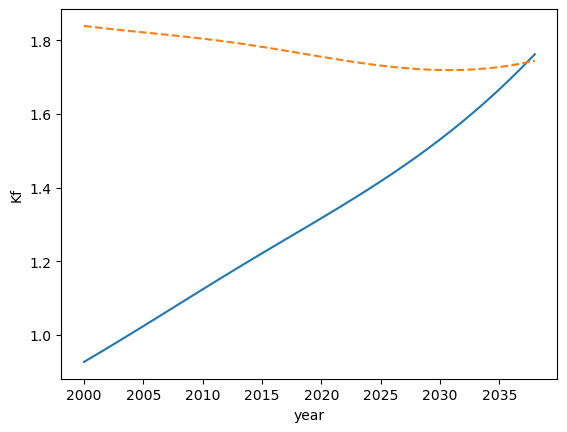

In [153]:
resu_hist.Ef.plot()
(resu_hist.Kf).plot(ls = '--')

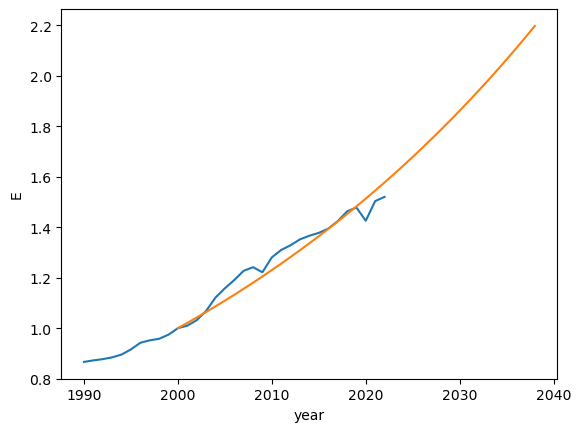

In [146]:
E_obs.sel(year = slice(1990, 2040)).plot()
resu_hist.sel(year = slice(1990, 2040)).E.plot()

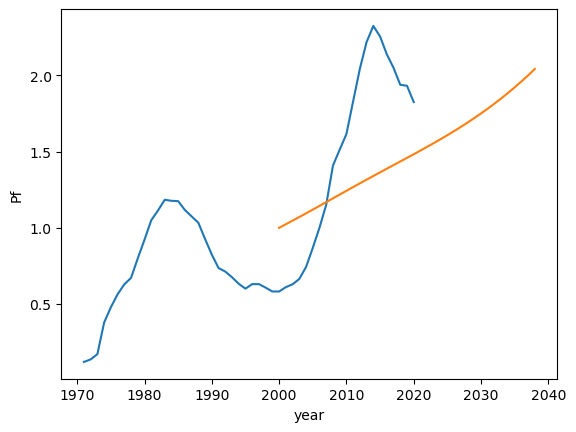

In [147]:
(lef.Pf_obs/lef.Pf_obs.sel(year=2000)).rolling(year=10,min_periods=1).mean().plot()
(resu_hist.Pf/resu_hist.Pf.sel(year=2000)).plot()

### WITH FCU = 0.8

In [154]:
fcu = 0.8
inicond = lef.inicond_yr(2000)
inicond['Kf_ini'] = inicond['Kf_ini']*lef.fossil_capacity_util/fcu

In [163]:
# parnames = ['beta_0', 'r_inv', 'a', 'delta_sig']
# initial_guess = [0.2, 0.1, 1., 0.7]#, 1.]
# bounds = [(-0.5, 0.5), (0.01, 0.4), (0.5, 1.5), (0.01, 2.)]#, (0.5, 1.5)]

parnames = ['growth', 'beta_0', 'r_inv', 'a', 'delta_sig']
initial_guess = [0.02, 0.2, 0.1, 1., 0.7]#, 1.]
bounds = [(0.001, 0.03), (-0.5, 0.5), (0.01, 0.4), (0.5, 1.5), (0.01, 2.)]#, (0.5, 1.5)]

year_ini = 2000

params = lef.default_params.copy()
print(params)
print('-------------')
#params['growth'] = 0.029 # fixing Growth!

verbose = True
all_green = False
I_weight = 1.
# obs = None
# obs = dict()
# obs['Ig_ratio'] = lef.Ig_obs/(lef.Ig_obs+lef.If_obs)
# obs['Eg_ratio'] = lef.Eg_ratio

# linear_gdp = 0.02

# Step 5: Use an optimization function to find the best parameters
result = minimize(lef.cost_function, initial_guess, bounds = bounds, args = (parnames, params, year_ini, inicond, verbose, all_green, I_weight, obs), tol = 1e-10)
# result = minimize(lef.cost_function, initial_guess, bounds = bounds, args = (parnames, params, year_ini, lef.inicond_yr(year_ini), verbose, all_green, I_weight, obs, linear_gdp), tol = 1e-10)
print(result)

{'growth': 0.01, 'eps': 1, 'a': 1, 'b': 1, 'gamma_f': 0.5, 'gamma_g': 0.5, 'eta_g': 0.2, 'eta_f': 0.2, 'h_g': 0.5, 'h_f': 0.5, 'r_inv': 0.1, 'beta_0': 0.2, 'delta_sig': 0.5, 'delta_g': 0.01, 'delta_f': 0.01, 'f_heavy': 0.1}
-------------
False 1.0 {'Eg_ratio': <xarray.DataArray (year: 59)>
array([0.06445519, 0.06516204, 0.06423987, 0.06390145, 0.0632996 ,
       0.06240231, 0.06275118, 0.06231038, 0.0598148 , 0.06527657,
       0.06561374, 0.06222023, 0.06216026, 0.06474634, 0.06588326,
       0.06803658, 0.06985936, 0.07187162, 0.07396094, 0.07347961,
       0.07309479, 0.07285027, 0.07142948, 0.0710847 , 0.06987618,
       0.07182692, 0.07301195, 0.07286488, 0.07653918, 0.07632168,
       0.07871824, 0.07755703, 0.07847491, 0.07890869, 0.07853059,
       0.07815846, 0.07552836, 0.07566855, 0.07334207, 0.07518   ,
       0.0756382 , 0.07705343, 0.07747336, 0.08245706, 0.08564856,
       0.08797048, 0.08980997, 0.09414955, 0.09847355, 0.10218171,
       0.10504495, 0.10980251, 0.113372

In [164]:
for par, val in zip(parnames, result.x):
    print(par, val)

growth 0.0209418049925536
beta_0 -0.2831097084724121
r_inv 0.11684169484450775
a 0.9418414596187906
delta_sig 0.47990969261681554


In [ ]:
year_ini = 2000

params = lef.default_params.copy()

for par, parval in zip(parnames, result.x):
    params[par] = parval

#resu_hist = lef.run_model(inicond = lef.inicond_yr(year_ini), params = params, n_iter = 100, verbose = True, rule = 'maxgreen', year_ini = year_ini, linear_gdp = linear_gdp)
resu_hist = lef.run_model(inicond = inicond, params = params, n_iter = 100, verbose = True, rule = 'maxgreen', year_ini = year_ini)
lef.plot_resu(resu_hist, year_ini = year_ini)
lef.plot_resuvsobs(resu_hist, year_ini = year_ini)

yini = year_ini
#print(yini + resu['year_peak'], yini + resu['year_halved'], yini + resu['year_zero'])

cost = lef.costfun(resu_hist, obs)#, weights = weights)
print(cost)

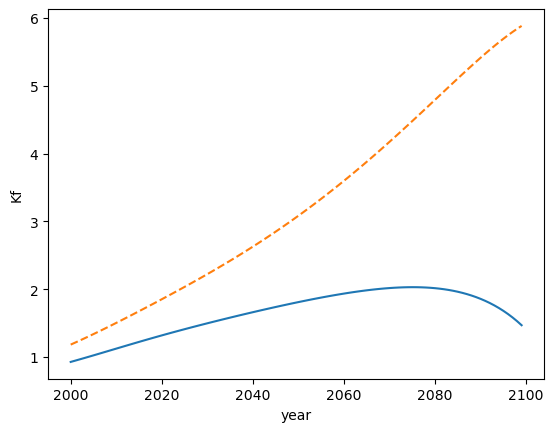

In [166]:
resu_hist.Ef.plot()
(resu_hist.Kf).plot(ls = '--')

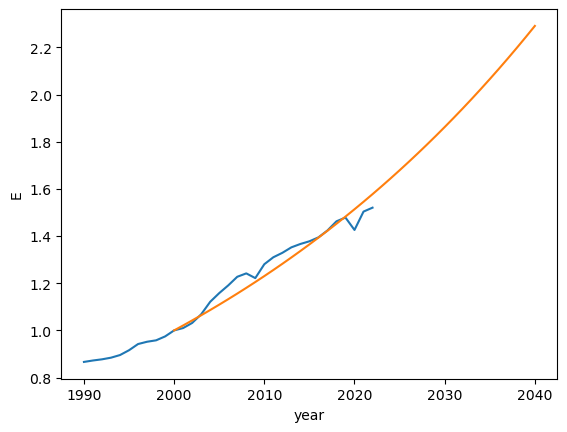

In [167]:
E_obs.sel(year = slice(1990, 2040)).plot()
resu_hist.sel(year = slice(1990, 2040)).E.plot()

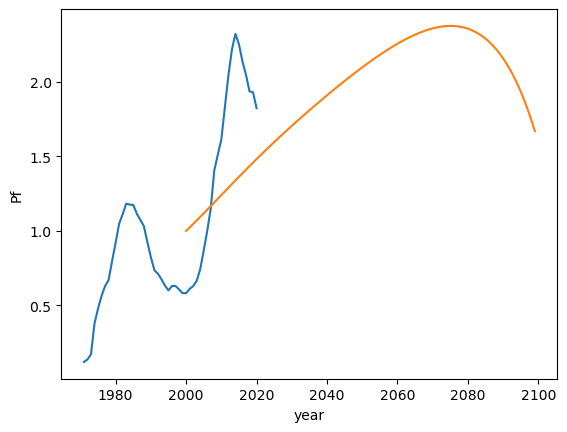

In [168]:
(lef.Pf_obs/lef.Pf_obs.sel(year=2000)).rolling(year=10,min_periods=1).mean().plot()
(resu_hist.Pf/resu_hist.Pf.sel(year=2000)).plot()

In [169]:
co2 = xr.load_dataset('co2_emiss_1750-2022.nc')['co2']

No handles with labels found to put in legend.


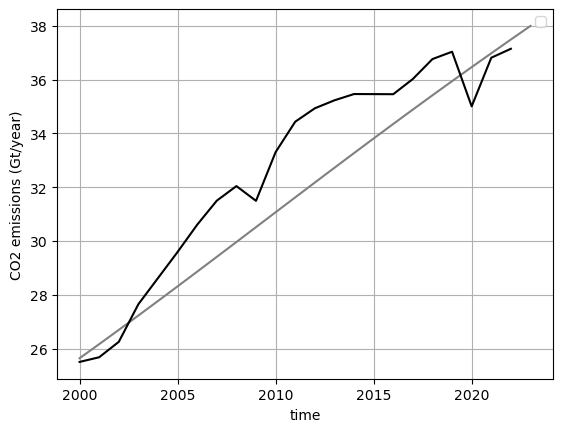

In [170]:
fig = plt.figure()

# for gro, re, col in zip(np.arange(0., 0.06, 0.01), allresu, rainbow_palette[::-1]):
#     lef.to_emissions(re['Ef']).plot(label = f'Growth: {int(100*gro)} %', color = col)

lef.to_emissions(resu_hist['Ef']).sel(year = slice(2000, 2023)).plot(color = 'grey')
co2.sel(year = slice(2000, 2023)).plot(color = 'black')
# lef.Eg_ratio.plot(label = 'obs', color = 'black')

plt.xlabel('time')
plt.ylabel('CO2 emissions (Gt/year)')
plt.legend()
plt.grid()